<a href="https://colab.research.google.com/github/keerthucit/EIP2Assignment/blob/master/Assignment5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
from __future__ import print_function
import keras
from keras.layers import Dense, Conv2D, BatchNormalization, Activation
from keras.layers import AveragePooling2D, Input, Flatten
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint, LearningRateScheduler
from keras.callbacks import ReduceLROnPlateau
from keras.preprocessing.image import ImageDataGenerator
from keras.regularizers import l2
from keras import backend as K
from keras.models import Model
from keras.datasets import cifar10
import numpy as np
import os

Using TensorFlow backend.


In [0]:
batch_size = 32  # orig paper trained all networks with batch_size=128
epochs = 200
data_augmentation = True
num_classes = 10

In [0]:

# Subtracting pixel mean improves accuracy
subtract_pixel_mean = True


In [0]:
# Model parameter
# ----------------------------------------------------------------------------
#           |      | 200-epoch | Orig Paper| 200-epoch | Orig Paper| sec/epoch
# Model     |  n   | ResNet v1 | ResNet v1 | ResNet v2 | ResNet v2 | GTX1080Ti
#           |v1(v2)| %Accuracy | %Accuracy | %Accuracy | %Accuracy | v1 (v2)
# ----------------------------------------------------------------------------
# ResNet20  | 3 (2)| 92.16     | 91.25     | -----     | -----     | 35 (---)
# ResNet32  | 5(NA)| 92.46     | 92.49     | NA        | NA        | 50 ( NA)
# ResNet44  | 7(NA)| 92.50     | 92.83     | NA        | NA        | 70 ( NA)
# ResNet56  | 9 (6)| 92.71     | 93.03     | 93.01     | NA        | 90 (100)
# ResNet110 |18(12)| 92.65     | 93.39+-.16| 93.15     | 93.63     | 165(180)
# ResNet164 |27(18)| -----     | 94.07     | -----     | 94.54     | ---(---)
# ResNet1001| (111)| -----     | 92.39     | -----     | 95.08+-.14| ---(---)
# ---------------------------------------------------------------------------
n = 3

# Model version
# Orig paper: version = 1 (ResNet v1), Improved ResNet: version = 2 (ResNet v2)
version = 1

# Computed depth from supplied model parameter n
if version == 1:
    depth = n * 6 + 2
elif version == 2:
    depth = n * 9 + 2

# Model name, depth and version
model_type = 'ResNet%dv%d' % (depth, version)

In [0]:

# Load the CIFAR10 data.
(x_train, y_train), (x_test, y_test) = cifar10.load_data()


170500096/170498071 [==============================] - 4s 0us/step


In [0]:
# Input image dimensions.
input_shape = x_train.shape[1:]

# Normalize data.
x_train = x_train.astype('float32') / 255
x_test = x_test.astype('float32') / 255

# If subtract pixel mean is enabled
if subtract_pixel_mean:
    x_train_mean = np.mean(x_train, axis=0)
    x_train -= x_train_mean
    x_test -= x_train_mean

print('x_train shape:', x_train.shape)
print(x_train.shape[0], 'train samples')
print(x_test.shape[0], 'test samples')
print('y_train shape:', y_train.shape)

x_train shape: (50000, 32, 32, 3)
50000 train samples
10000 test samples
y_train shape: (50000, 1)


In [0]:
# Convert class vectors to binary class matrices.
y_train = keras.utils.to_categorical(y_train, num_classes)
y_test = keras.utils.to_categorical(y_test, num_classes)


In [0]:
print('y_train shape:', y_train.shape)
print(y_train.shape[0], 'train samples')
print(y_test.shape[0], 'test samples')
print('y_test shape:', y_test.shape)

y_train shape: (50000, 10)
50000 train samples
10000 test samples
y_test shape: (10000, 10)


In [0]:
def lr_schedule(epoch):
    """Learning Rate Schedule

    Learning rate is scheduled to be reduced after 80, 120, 160, 180 epochs.
    Called automatically every epoch as part of callbacks during training.

    # Arguments
        epoch (int): The number of epochs

    # Returns
        lr (float32): learning rate
    """
    lr = 1e-3
    if epoch > 180:
        lr *= 0.5e-3
        print('Learning rate: ', lr)
    elif epoch > 160:
        lr *= 1e-3
        print('Learning rate: ', lr)
    elif epoch > 120:
        lr *= 1e-2
        print('Learning rate: ', lr)
    elif epoch > 80:
        lr *= 1e-1
    print('Learning rate: ', lr)
    return lr



In [0]:
def resnet_layer(inputs,
                 num_filters=16,
                 kernel_size=3,
                 strides=1,
                 activation='relu',
                 batch_normalization=True,
                 conv_first=True):
    """2D Convolution-Batch Normalization-Activation stack builder

    # Arguments
        inputs (tensor): input tensor from input image or previous layer
        num_filters (int): Conv2D number of filters
        kernel_size (int): Conv2D square kernel dimensions
        strides (int): Conv2D square stride dimensions
        activation (string): activation name
        batch_normalization (bool): whether to include batch normalization
        conv_first (bool): conv-bn-activation (True) or
            bn-activation-conv (False)

    # Returns
        x (tensor): tensor as input to the next layer
    """
    conv = Conv2D(num_filters,
                  kernel_size=kernel_size,
                  strides=strides,
                  padding='same',
                  kernel_initializer='he_normal',
                  kernel_regularizer=l2(1e-4))

    x = inputs
    if conv_first:
        x = conv(x)
        if batch_normalization:
            x = BatchNormalization()(x)
        if activation is not None:
            x = Activation(activation)(x)
    else:
        if batch_normalization:
            x = BatchNormalization()(x)
        if activation is not None:
            x = Activation(activation)(x)
        x = conv(x)
    return x


In [0]:

def resnet_v1(input_shape, depth, num_classes=10):
    """ResNet Version 1 Model builder [a]

    Stacks of 2 x (3 x 3) Conv2D-BN-ReLU
    Last ReLU is after the shortcut connection.
    At the beginning of each stage, the feature map size is halved (downsampled)
    by a convolutional layer with strides=2, while the number of filters is
    doubled. Within each stage, the layers have the same number filters and the
    same number of filters.
    Features maps sizes:
    stage 0: 32x32, 16
    stage 1: 16x16, 32
    stage 2:  8x8,  64
    The Number of parameters is approx the same as Table 6 of [a]:
    ResNet20 0.27M
    ResNet32 0.46M
    ResNet44 0.66M
    ResNet56 0.85M
    ResNet110 1.7M

    # Arguments
        input_shape (tensor): shape of input image tensor
        depth (int): number of core convolutional layers
        num_classes (int): number of classes (CIFAR10 has 10)

    # Returns
        model (Model): Keras model instance
    """
    if (depth - 2) % 6 != 0:
        raise ValueError('depth should be 6n+2 (eg 20, 32, 44 in [a])')
    # Start model definition.
    num_filters = 16
    num_res_blocks = int((depth - 2) / 6)

    inputs = Input(shape=input_shape)
    x = resnet_layer(inputs=inputs)
    # Instantiate the stack of residual units
    for stack in range(3):
        for res_block in range(num_res_blocks):
            strides = 1
            if stack > 0 and res_block == 0:  # first layer but not first stack
                strides = 2  # downsample
            y = resnet_layer(inputs=x,
                             num_filters=num_filters,
                             strides=strides)
            y = resnet_layer(inputs=y,
                             num_filters=num_filters,
                             activation=None)
            if stack > 0 and res_block == 0:  # first layer but not first stack
                # linear projection residual shortcut connection to match
                # changed dims
                x = resnet_layer(inputs=x,
                                 num_filters=num_filters,
                                 kernel_size=1,
                                 strides=strides,
                                 activation=None,
                                 batch_normalization=False)
            x = keras.layers.add([x, y])
            x = Activation('relu')(x)
        num_filters *= 2

    # Add classifier on top.
    # v1 does not use BN after last shortcut connection-ReLU
    x = AveragePooling2D(pool_size=8)(x)
    y = Flatten()(x)
    outputs = Dense(num_classes,
                    activation='softmax',
                    kernel_initializer='he_normal')(y)

    # Instantiate model.
    model = Model(inputs=inputs, outputs=outputs)
    return model

In [0]:
def resnet_v2(input_shape, depth, num_classes=10):
    """ResNet Version 2 Model builder [b]

    Stacks of (1 x 1)-(3 x 3)-(1 x 1) BN-ReLU-Conv2D or also known as
    bottleneck layer
    First shortcut connection per layer is 1 x 1 Conv2D.
    Second and onwards shortcut connection is identity.
    At the beginning of each stage, the feature map size is halved (downsampled)
    by a convolutional layer with strides=2, while the number of filter maps is
    doubled. Within each stage, the layers have the same number filters and the
    same filter map sizes.
    Features maps sizes:
    conv1  : 32x32,  16
    stage 0: 32x32,  64
    stage 1: 16x16, 128
    stage 2:  8x8,  256

    # Arguments
        input_shape (tensor): shape of input image tensor
        depth (int): number of core convolutional layers
        num_classes (int): number of classes (CIFAR10 has 10)

    # Returns
        model (Model): Keras model instance
    """
    if (depth - 2) % 9 != 0:
        raise ValueError('depth should be 9n+2 (eg 56 or 110 in [b])')
    # Start model definition.
    num_filters_in = 16
    num_res_blocks = int((depth - 2) / 9)

    inputs = Input(shape=input_shape)
    # v2 performs Conv2D with BN-ReLU on input before splitting into 2 paths
    x = resnet_layer(inputs=inputs,
                     num_filters=num_filters_in,
                     conv_first=True)

    # Instantiate the stack of residual units
    for stage in range(3):
        for res_block in range(num_res_blocks):
            activation = 'relu'
            batch_normalization = True
            strides = 1
            if stage == 0:
                num_filters_out = num_filters_in * 4
                if res_block == 0:  # first layer and first stage
                    activation = None
                    batch_normalization = False
            else:
                num_filters_out = num_filters_in * 2
                if res_block == 0:  # first layer but not first stage
                    strides = 2    # downsample

            # bottleneck residual unit
            y = resnet_layer(inputs=x,
                             num_filters=num_filters_in,
                             kernel_size=1,
                             strides=strides,
                             activation=activation,
                             batch_normalization=batch_normalization,
                             conv_first=False)
            y = resnet_layer(inputs=y,
                             num_filters=num_filters_in,
                             conv_first=False)
            y = resnet_layer(inputs=y,
                             num_filters=num_filters_out,
                             kernel_size=1,
                             conv_first=False)
            if res_block == 0:
                # linear projection residual shortcut connection to match
                # changed dims
                x = resnet_layer(inputs=x,
                                 num_filters=num_filters_out,
                                 kernel_size=1,
                                 strides=strides,
                                 activation=None,
                                 batch_normalization=False)
            x = keras.layers.add([x, y])

        num_filters_in = num_filters_out

    # Add classifier on top.
    # v2 has BN-ReLU before Pooling
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = AveragePooling2D(pool_size=8)(x)
    y = Flatten()(x)
    outputs = Dense(num_classes,
                    activation='softmax',
                    kernel_initializer='he_normal')(y)

    # Instantiate model.
    model = Model(inputs=inputs, outputs=outputs)
    return model



In [0]:
if version == 2:
    model = resnet_v2(input_shape=input_shape, depth=depth)
else:
    model = resnet_v1(input_shape=input_shape, depth=depth)

model.compile(loss='categorical_crossentropy',
              optimizer=Adam(lr=lr_schedule(0)),
              metrics=['accuracy'])
model.summary()
print(model_type)

W0701 04:10:41.702316 140303562061696 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0701 04:10:41.754032 140303562061696 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0701 04:10:41.764519 140303562061696 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:4185: The name tf.truncated_normal is deprecated. Please use tf.random.truncated_normal instead.

W0701 04:10:41.841815 140303562061696 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:174: The name tf.get_default_session is deprecated. Please use tf.compat.v1.get_default_session instead.

W0701 04:10:41.842978

Learning rate:  0.001
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 32, 32, 3)    0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 32, 32, 16)   448         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 32, 32, 16)   64          conv2d_1[0][0]                   
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 32, 32, 16)   0           batch_normalization_1[0][0]      
_______________________________________________________________________________________

In [0]:
# Prepare model model saving directory.
save_dir = os.path.join(os.getcwd(), 'saved_models')
model_name = 'cifar10_%s_model.{epoch:03d}.h5' % model_type
if not os.path.isdir(save_dir):
    os.makedirs(save_dir)
filepath = os.path.join(save_dir, model_name)

# Prepare callbacks for model saving and for learning rate adjustment.
checkpoint = ModelCheckpoint(filepath=filepath,
                             monitor='val_acc',
                             verbose=1,
                             save_best_only=True)

lr_scheduler = LearningRateScheduler(lr_schedule)

lr_reducer = ReduceLROnPlateau(factor=np.sqrt(0.1),
                               cooldown=0,
                               patience=5,
                               min_lr=0.5e-6)

callbacks = [checkpoint, lr_reducer, lr_scheduler]
print('Model Name --->  ',model_name)
print('cifar10_%s_model.{epoch:03d}.h5' % model_type)

Model Name --->   cifar10_ResNet20v1_model.{epoch:03d}.h5
cifar10_ResNet20v1_model.{epoch:03d}.h5


In [0]:
# Run training, with or without data augmentation.
if not data_augmentation:
    print('Not using data augmentation.')
    model.fit(x_train, y_train,
              batch_size=batch_size,
              epochs=epochs,
              validation_data=(x_test, y_test),
              shuffle=True,
              callbacks=callbacks)
else:
    print('Using real-time data augmentation.')
    # This will do preprocessing and realtime data augmentation:
    datagen = ImageDataGenerator(
        # set input mean to 0 over the dataset
        featurewise_center=False,
        # set each sample mean to 0
        samplewise_center=False,
        # divide inputs by std of dataset
        featurewise_std_normalization=False,
        # divide each input by its std
        samplewise_std_normalization=False,
        # apply ZCA whitening
        zca_whitening=False,
        # epsilon for ZCA whitening
        zca_epsilon=1e-06,
        # randomly rotate images in the range (deg 0 to 180)
        rotation_range=0,
        # randomly shift images horizontally
        width_shift_range=0.1,
        # randomly shift images vertically
        height_shift_range=0.1,
        # set range for random shear
        shear_range=0.,
        # set range for random zoom
        zoom_range=0.,
        # set range for random channel shifts
        channel_shift_range=0.,
        # set mode for filling points outside the input boundaries
        fill_mode='nearest',
        # value used for fill_mode = "constant"
        cval=0.,
        # randomly flip images
        horizontal_flip=True,
        # randomly flip images
        vertical_flip=False,
        # set rescaling factor (applied before any other transformation)
        rescale=None,
        # set function that will be applied on each input
        preprocessing_function=None,
        # image data format, either "channels_first" or "channels_last"
        data_format=None,
        # fraction of images reserved for validation (strictly between 0 and 1)
        validation_split=0.0)


Using real-time data augmentation.


In [0]:
 # Compute quantities required for featurewise normalization
    # (std, mean, and principal components if ZCA whitening is applied).
    datagen.fit(x_train)
    print(datagen.fit(x_train))


None


In [0]:
  # Compute quantities required for featurewise normalization
    # (std, mean, and principal components if ZCA whitening is applied).
    datagen.fit(x_train)
   

  # Fit the model on the batches generated by datagen.flow().
    model.fit_generator(datagen.flow(x_train, y_train, batch_size=batch_size),
                        validation_data=(x_test, y_test),steps_per_epoch = 10,
                        epochs=epochs, verbose=1, workers=4,
                        callbacks=callbacks)

W0701 04:11:08.962760 140303562061696 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/math_grad.py:1250: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Epoch 1/200
Learning rate:  0.001
10/10 [==============================] - 70s 7s/step - loss: 3.0584 - acc: 0.1500 - val_loss: 2.9921 - val_acc: 0.1687

Epoch 00001: val_acc improved from -inf to 0.16870, saving model to /content/saved_models/cifar10_ResNet20v1_model.001.h5
Epoch 2/200
Learning rate:  0.001
10/10 [==============================] - 61s 6s/step - loss: 2.3869 - acc: 0.1719 - val_loss: 2.4885 - val_acc: 0.1515

Epoch 00002: val_acc did not improve from 0.16870
Epoch 3/200
Learning rate:  0.001
10/10 [==============================] - 62s 6s/step - loss: 2.2657 - acc: 0.2500 - val_loss: 2.5606 - val_acc: 0.1960

Epoch 00003: val_acc improved from 0.16870 to 0.19600, saving model to /content/saved_models/cifar10_ResNet20v1_model.003.h5
Epoch 4/200
Learning rate:  0.001
10/10 [==============================] - 61s 6s/step - loss: 2.1870 - acc: 0.2281 - val_loss: 2.5141 - val_acc: 0.1859

Epoch 00004: val_acc did not improve from 0.19600
Epoch 5/200
Learning rate:  0.001
10/

W0701 07:00:13.863469 140303562061696 image.py:648] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


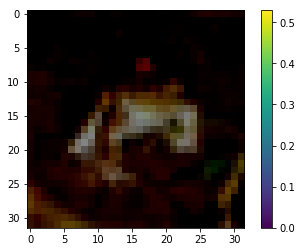

In [0]:
import matplotlib.pyplot as plt
plt.figure()
plt.imshow(x_train[0])
plt.colorbar()
plt.grid(False)
plt.show()

In [0]:

incorrects = np.nonzero(model.predict(x_test).reshape((-1,)) != y_test)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  


In [0]:
# Score trained model.
scores = model.evaluate(x_test, y_test, verbose=1)
print('Test loss:', scores[0])
print('Test accuracy:', scores[1])

10000/10000 [==============================] - 46s 5ms/step
Test loss: 1.2781192834854127
Test accuracy: 0.5989


In [0]:
def image_to_feature_vector(image, size=(28, 28)):

    return cv2.resize(image, size).flatten()


In [0]:
def predict_classes(self, x, batch_size=32, verbose=1):
    '''Generate class predictions for the input samples
    batch by batch.
    # Arguments
        x: input data, as a Numpy array or list of Numpy arrays
            (if the model has multiple inputs).
        batch_size: integer.
        verbose: verbosity mode, 0 or 1.
    # Returns
        A numpy array of class predictions.
    '''
    proba = self.predict(x, batch_size=batch_size, verbose=verbose)
    if proba.shape[-1] > 1:
        return proba.argmax(axis=-1)
    else:
        return (proba > 0.5).astype('int32')

In [0]:
y_prob = model.predict(x_test) 
y_classes = y_prob.argmax(axis=-1)
print(y_prob)
print(y_classes)

[[6.14892645e-03 6.49236888e-03 1.35501213e-02 ... 2.80454140e-02
  2.82712001e-02 1.40214935e-02]
 [3.82194333e-02 4.33437020e-01 5.83460147e-04 ... 7.92429637e-05
  4.92831022e-01 3.41260955e-02]
 [4.19297144e-02 1.20822124e-01 4.34638700e-03 ... 4.81684878e-03
  7.59059966e-01 5.29684536e-02]
 ...
 [4.93980362e-04 9.62106424e-05 1.41658545e-01 ... 7.57478625e-02
  4.91135579e-04 1.75821129e-04]
 [1.81656823e-01 5.80094159e-01 3.16507630e-02 ... 8.77480507e-02
  2.86199432e-03 1.70287564e-02]
 [9.50502232e-04 2.76208215e-04 4.46228962e-03 ... 8.72744977e-01
  7.60287221e-05 1.00761850e-03]]
[5 8 8 ... 5 1 7]


In [0]:
import cv2
predicted_classes = model.predict(x_test) 
data3=x_test[incorrect]
data3 = np.arange(122304).reshape(52, 2352 )
data3 = data3.reshape((data3.shape[0]*3, 28, 28))
print(data3.shape)

(156, 28, 28)


W0701 10:00:45.292791 140303562061696 image.py:648] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0701 10:00:45.309612 140303562061696 image.py:648] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0701 10:00:45.324390 140303562061696 image.py:648] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0701 10:00:45.339211 140303562061696 image.py:648] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0701 10:00:45.354586 140303562061696 image.py:648] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0701 10:00:45.370208 140303562061696 image.py:648] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0701 10:00:45.384877 140303


0 Classified correctly
100000 Classified Incorrectly


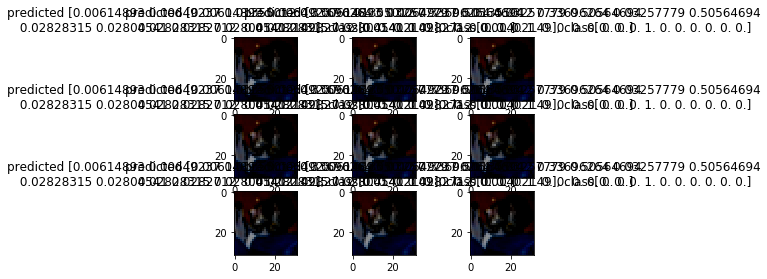

In [0]:
correct_indices=np.nonzero(predicted_classes == y_test)[0]
incorrect_indices=np.nonzero(predicted_classes != y_test)[0]
print()
print(len(correct_indices),"Classified correctly")
print(len(incorrect_indices),"Classified Incorrectly")
plt.figure()
for i, incorrect in enumerate(incorrect_indices[:9]):
  plt.subplot(3, 3, i+1)
  plt.imshow(x_test[incorrect].reshape(32, 32,3), cmap='gray',interpolation='nearest')
  plt.title("predicted {}, class{}".format(predicted_classes[incorrect],y_test[incorrect]))
plt.show()
  

In [0]:
for i in range(len(x_test)):
	print("X=%s, Predicted=%s" % (x_test[i], y_test[i]))

X=[[[ 0.10701877 -0.09433994 -0.32766396]
  [ 0.11317378 -0.09585628 -0.33276415]
  [ 0.1331346  -0.07939962 -0.31993282]
  ...
  [ 0.02329487 -0.16199306 -0.37820596]
  [-0.01722959 -0.17533323 -0.37647754]
  [-0.05558571 -0.1979411  -0.3878175 ]]

 [[ 0.08588803 -0.09135368 -0.31515366]
  [ 0.08492362 -0.0959219  -0.35477054]
  [ 0.1128763  -0.08304891 -0.3376581 ]
  ...
  [ 0.02336073 -0.15741041 -0.39177167]
  [-0.01698247 -0.17082289 -0.3862744 ]
  [-0.03983071 -0.18189994 -0.37824136]]

 [[ 0.08343416 -0.09665951 -0.3264755 ]
  [ 0.08738601 -0.09607032 -0.37654787]
  [ 0.11186892 -0.09041616 -0.36657542]
  ...
  [ 0.03838682 -0.14101735 -0.37370574]
  [ 0.0055232  -0.15114662 -0.37280858]
  [-0.0336912  -0.17473862 -0.3773507 ]]

 ...

 [[-0.22962278 -0.00766507  0.24649686]
  [-0.3238762  -0.09307429  0.14203972]
  [-0.3644128  -0.13647798  0.10299587]
  ...
  [-0.33819658 -0.10197604  0.13776007]
  [-0.43799633 -0.23430142 -0.01471004]
  [-0.33535796 -0.15631485  0.05449003]]



IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



X=[[[ 0.4638815   0.45467967  0.38998312]
  [ 0.4582718   0.44924176  0.3888045 ]
  [ 0.45862478  0.45001215  0.38987112]
  ...
  [ 0.47035366  0.44585007  0.3904215 ]
  [ 0.46904492  0.4442746   0.38822836]
  [ 0.47774762  0.4530393   0.39257467]]

 [[ 0.45451546  0.44590122  0.38288558]
  [ 0.43786478  0.44525456  0.38248438]
  [ 0.4462096   0.43459815  0.3760674 ]
  ...
  [ 0.4625764   0.438668    0.38469893]
  [ 0.4614489   0.43702024  0.38235307]
  [ 0.46605164  0.44162947  0.38646454]]

 [[ 0.45598316  0.44843853  0.39117157]
  [ 0.4364056   0.46079242  0.3920796 ]
  [ 0.37853557  0.36840737  0.31577754]
  ...
  [ 0.46583778  0.44329637  0.39100015]
  [ 0.4643467   0.44101024  0.38797575]
  [ 0.47219115  0.4487908   0.39519835]]

 ...

 [[ 0.48018113  0.47860944  0.45433998]
  [ 0.48004535  0.47947472  0.4557652 ]
  [ 0.4865676   0.48705143  0.46378016]
  ...
  [-0.17349067 -0.1804074  -0.15635759]
  [ 0.28357232  0.2755025   0.29117233]
  [ 0.49601457  0.4985871   0.49370572]]



In [0]:

for i in range(len(x_test)):
  if y_test[i][0] == 1:
    plt.imshow(x_test[i])
plt.show()	   

In [0]:

# for i in range(len(x_test)):
import matplotlib.pyplot as plt
plt.figure(figsize=(10,10))
for i in range(1000):
  for j in range(len(y_test)):
    if j < 9 :
      if y_test[i][j] == 1:
         plt.imshow(x_test[i])
plt.show()	


In [0]:

#predict = model.predict(x_test, batch_size=1)
#print(predict)
#proba = model.predict_proba(x_test, batch_size=1)
#print(proba)
#predict_classes(self, x, batch_size=32, verbose=1)
#classes = model.predict_classes(x_test,  batch_size=32, verbose=1)
#print(classes)

In [0]:

#predicted_classes = model.predict_classes(x_test)


In [0]:
#classes = model.predict_classes(x_test, batch_size=1)
#print(classes)

W0627 08:17:12.544731 139907747514240 image.py:648] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
/usr/local/lib/python3.6/dist-packages/matplotlib/text.py:1191: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if s != self._text:
W0627 08:17:12.569545 139907747514240 image.py:648] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0627 08:17:12.588936 139907747514240 image.py:648] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0627 08:17:12.610551 139907747514240 image.py:648] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0627 08:17:12.630010 139907747514240 image.py:648] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0

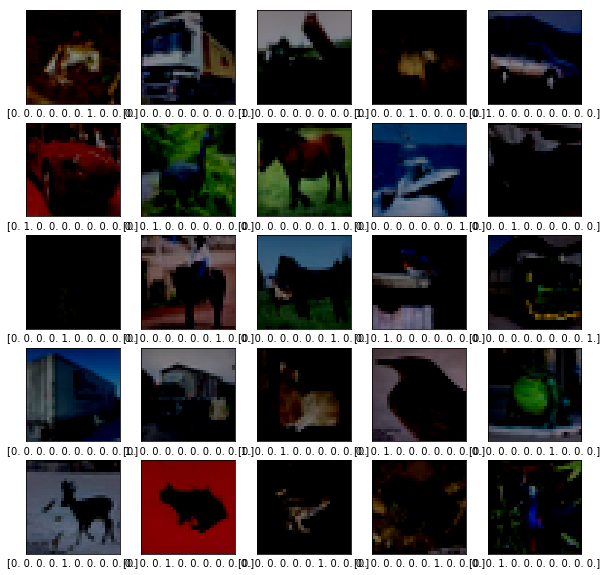

In [0]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10,10))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(x_train[i], cmap=plt.cm.binary)
    plt.xlabel(y_train[i])
plt.show()

In [0]:
from keras.applications.vgg16 import VGG16, preprocess_input, decode_predictions
from keras.preprocessing import image
import keras.backend as K
import numpy as np
import cv2
import sys
import tensorflow as tf

In [0]:
tensorFlowSession = K.get_session()
print(tensorFlowSession)
tf.saved_model.simple_save(tensorFlowSession, newpath + "/TensorFlow", inputs={"x": x}, outputs={"y": y})
tf.train.write_graph(tensorFlowSession.graph_def,newpath + "/TensorFlow",  "trainGraph_def.pbtxt")

In [0]:
model = VGG16(weights="imagenet")
img_path = sys.argv[1]
img = image.load_img(img_path, target_size=(224, 224))
x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)
x = preprocess_input(x)